# Deep learning : 2018 June Wheat Dataset

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import PIL
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense

In [2]:
import tensorflow as tf

In [3]:
pip install --upgrade tensorflow

Note: you may need to restart the kernel to use updated packages.


In [4]:
conda install -c conda-forge keras-preprocessing

Retrieving notices: ...working... done
Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [5]:
import pathlib
data_dir=pathlib.Path('/Users/trl102/datasets')
data_dir

PosixPath('/Users/trl102/datasets')

In [7]:
import os 
os.listdir('/Users/trl102/datasets')

['shownodes',
 '.DS_Store',
 'CLEAN_Wheat4_Full_experiment_root_length.csv',
 'Wheat4',
 'flower_photos.tar.gz',
 'RadimaxGPU',
 'history.csv',
 'isotope_dataframe.xlsx',
 'RootImage',
 'history.json',
 'RadiMaxDataPreProcessing.py',
 'CLEAN_Wheat3_Full_experiment_root_length.csv',
 'flower_photos.zip',
 'Wheat13_10-06-2020',
 'RadimaxDL.py',
 'SmallDataSet',
 'CLEAN_Wheat5_Full_experiment_root_length.csv']

# List of file names

In [8]:
Root_imgs_file_name=list(data_dir.glob('Wheat4/*.jpg'))

In [9]:
Root_imgs_file_name

[PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_92_Position_2886_TS_2018-06-18 14.26.18.776B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam2_PipeID_55_Position_4252_TS_2018-06-18 14.02.33.378B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam3_PipeID_74_Position_3446_TS_2018-06-18 13.53.59.962B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_144_Position_2886_TS_2018-06-18 16.01.42.384B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam3_PipeID_118_Position_2081_TS_2018-06-18 15.15.59.141B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam2_PipeID_3_Position_4285_TS_2018-06-18 11.38.15.512B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam4_PipeID_117_Position_4075_TS_2018-06-18 15.12.32.402B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam3_PipeID_126_Position_4322_TS_2018-06-18 15.26.04.530B.jpg'),
 PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_124_Position_2573_TS_20

# Number of images in June 2018

In [10]:
numImages=len(Root_imgs_file_name)
numImages

21290

# Visualize images of a particular tube at diffenet depth intevals

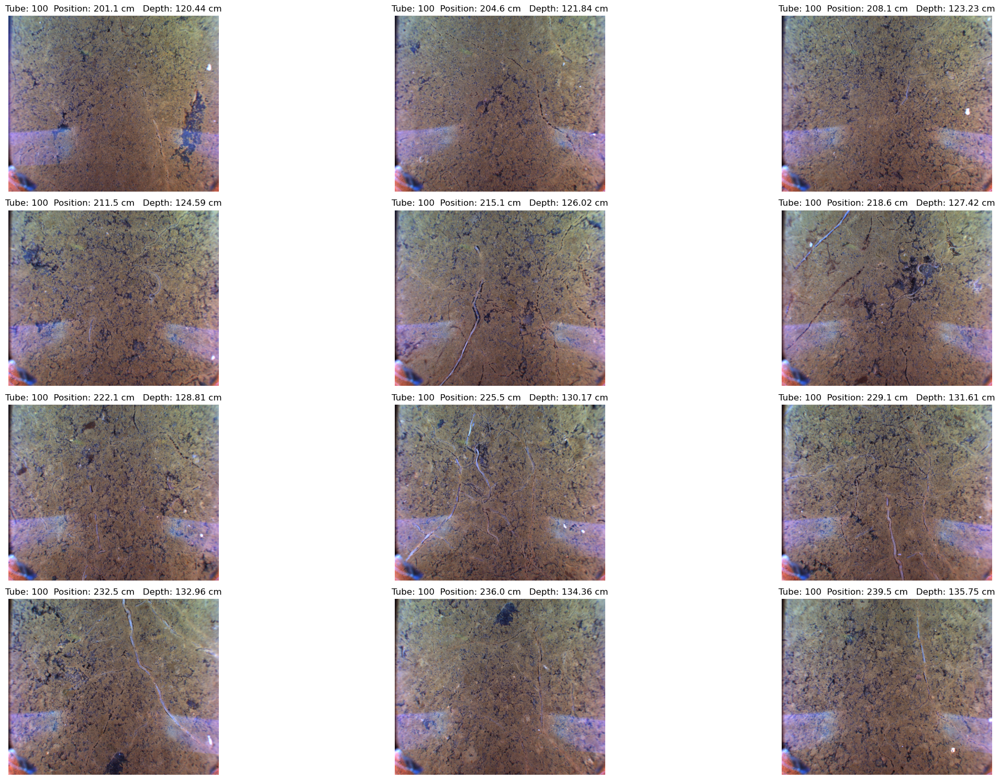

In [11]:
import cv2
import random
import matplotlib.pyplot as plt
plt.figure(figsize=(25,15))
#Get the images of a particular tube
import fnmatch
ptubeImage=[]

tubeNo=100

# Extarct image-file names of a particular tube x: tubeNo=x

for filename in list(data_dir.glob('Wheat4/*.jpg')):
    if fnmatch.fnmatch(filename, '*_PipeID_'+str(tubeNo)+'_*'):
        ptubeImage.append(filename)
ptubeImage=np.sort(ptubeImage)

for i in range(1,13):    
    plt.subplot(4,3,i) 
    x=1 # first sub interval of length around 20 cm
    j=i-1+(x-1)*12 # j=(i-1)+12 for next 12 images
    index=random.sample(range(0, numImages + 1), 1)[0]
    tube_no,position=[int(s) for s in str(ptubeImage[j]).split("_") if s.isdigit()][0:2]
    #position=[int(s) for s in str(Root_imgs_file_name[index]).split("_") if s.isdigit()][1]
    soil_depth=(((position-420)*np.sin((23.5*(np.pi/180)))+570))/10.0 # in cm
    RootImage = cv2.imread(str(ptubeImage[j]))   
    plt.imshow(cv2.cvtColor(RootImage, cv2.COLOR_BGR2RGB))
    plt.title("Tube: "+str(tube_no)+"  Position: "+str(position/10)+" cm"+"   Depth: "+str(np.round(soil_depth,2))+" cm")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [11]:
# Original shape of Image
RootImage.shape

(2048, 2448, 3)

# Number of images per tube

In [12]:
len(ptubeImage)

72

In [13]:
ptubeImage

array([PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2011_TS_2018-06-18 14.43.30.981B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2046_TS_2018-06-18 14.43.28.095B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2081_TS_2018-06-18 14.43.25.380B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2115_TS_2018-06-18 14.43.22.619B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2151_TS_2018-06-18 14.43.19.874B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2186_TS_2018-06-18 14.43.17.112B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2221_TS_2018-06-18 14.43.14.226B.jpg'),
       PosixPath('/Users/trl102/datasets/Wheat4/Radimax_Cam1_PipeID_100_Position_2255_TS_2018-06-18 14.43.11.512B.jpg'),
       PosixPath('/Users/trl102/

# Visualize  images randomly from the entire dataset

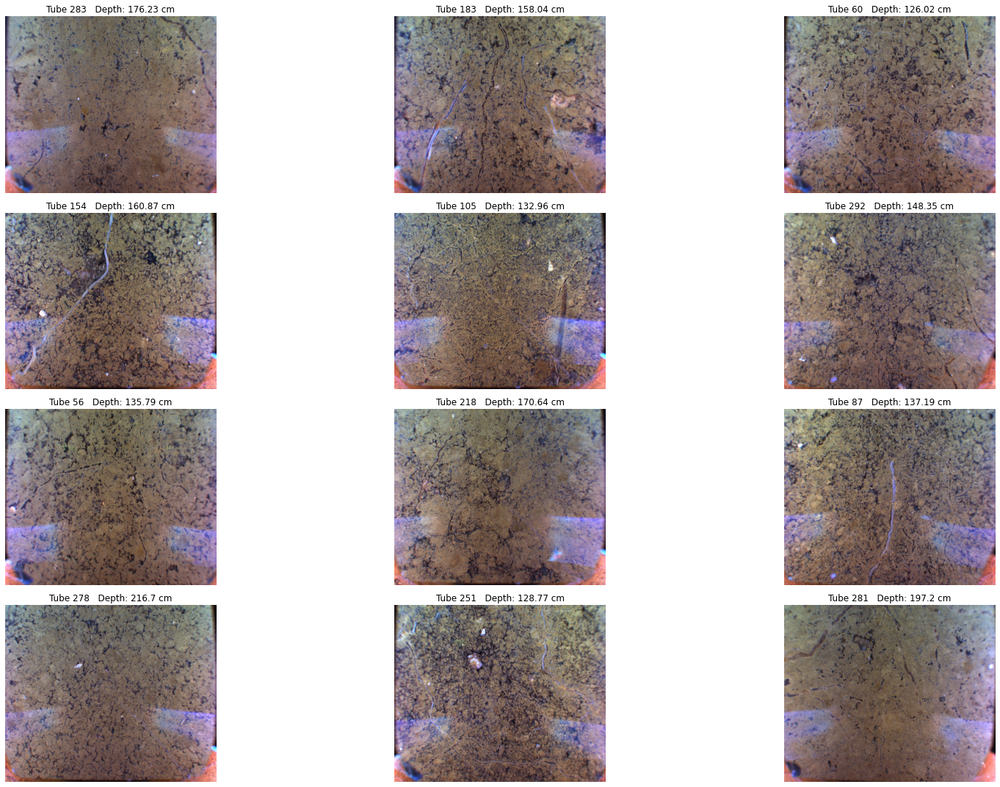

In [16]:
import cv2
import matplotlib.pyplot as plt
plt.figure(figsize=(25,15))

for i in range(1,13):
    plt.subplot(4,3,i) 
    index=random.sample(range(0, numImages + 1), 1)[0]
    tube_no,position=[int(s) for s in str(Root_imgs_file_name[index]).split("_") if s.isdigit()][0:2]
    #position=[int(s) for s in str(Root_imgs_file_name[index]).split("_") if s.isdigit()][1]
    soil_depth=(((position-420)*np.sin((23.5*(np.pi/180)))+570))/10.0 # in cm
    RootImage = cv2.imread(str(Root_imgs_file_name[index]))   
    plt.imshow(cv2.cvtColor(RootImage, cv2.COLOR_BGR2RGB))
    plt.title("Tube "+str(tube_no)+"   Depth: "+str(np.round(soil_depth,2))+" cm")
    plt.axis('off')    
    
plt.tight_layout()
plt.show()


# Get the isotope data

In [12]:
import pandas as pd
isotope_data=pd.read_excel('/Users/trl102/datasets/isotope_dataframe.xlsx')
idatap=isotope_data[(isotope_data['direction']=='S')&(isotope_data['bed']==1)| (isotope_data['direction']=='N')&(isotope_data['bed']==2)]
#idatap=isotope_data[(isotope_data['direction']=='S')&(isotope_data['bed']==2)]
#idatap.dropna(inplace=True)
idatap.reset_index(drop=True,inplace=True)
idatap_copy=idatap.loc[:,['row','δ15N (Air)']].copy()
idatap_copy.set_index('row',inplace=True)

# Get the pRLD data of June 2018

In [14]:
data_June18_raw=pd.read_csv('/Users/trl102/datasets/CLEAN_Wheat4_Full_experiment_root_length.csv')
# Importing RadiMax modules for RLD data preprocessing
from RadiMaxDataPreProcessing import (
    RL_processing,
    fun_RL_computation,
    isotope_data_preprocess,
    plot_RL,
)

# Processing 2018 RL data for getting root lengths from pixels values
_, pRLJune18_SR, _ = RL_processing(
    data_June18_raw.copy(),
    data_June18_raw.copy(),
    data_June18_raw.copy(),
    Square_root=True,
)

In [15]:
pRLJune18_SR.sort_values(by='tube').head(50)

,Camera,tube,Depth,Date,Root_length,soil_depth
14365,Cam4,1,3689,18/06/2018,0.360710,187.351071
8611,Cam4,1,2816,18/06/2018,0.370873,152.540277
10676,Cam4,1,2116,18/06/2018,1.396357,124.627842
5516,Cam4,1,2851,18/06/2018,0.325496,153.935899
18766,Cam4,1,3866,18/06/2018,0.448044,194.408929
6102,Cam4,1,3305,18/06/2018,0.584814,172.039106
12279,Cam4,1,3655,18/06/2018,0.105605,185.995324
18335,Cam4,1,3341,18/06/2018,0.331158,173.474603
14422,Cam4,1,3411,18/06/2018,0.350252,176.265847
7286,Cam4,1,3935,18/06/2018,0.506464,197.160298


# Create dataframe of image paths for flow_from_dataframe


In [18]:
#DataFrame for metadata of the files
import pandas as pd
df=pd.DataFrame(columns=['id','Isotope','pRLD','tube_depth','tube'])
df['id']=Root_imgs_file_name
df['Isotope']=np.zeros(len(Root_imgs_file_name))
df['pRLD']=np.zeros(len(Root_imgs_file_name))
df['tube_depth']=np.zeros(len(Root_imgs_file_name))
df['tube']=np.zeros(len(Root_imgs_file_name))

In [19]:
df

,id,Isotope,pRLD,tube_depth,tube
0,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,0.0,0.0,0.0,0.0
1,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.0,0.0,0.0,0.0
2,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.0,0.0,0.0,0.0
3,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,0.0,0.0,0.0,0.0
4,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.0,0.0,0.0,0.0
...,...,...,...,...,...
21285,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.0,0.0,0.0,0.0
21286,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,0.0,0.0,0.0,0.0
21287,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.0,0.0,0.0,0.0
21288,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.0,0.0,0.0,0.0


In [20]:
pRLJune18_SR.set_index('tube',inplace=True)

In [21]:
pRLJune18_SR_copy=pRLJune18_SR.loc[:,['Depth','Root_length']].copy()

# Function : extracting tube number and lebel the images with isotope and pRLD

In [22]:
def f(x):
    tube_no,position=[int(s) for s in str(x[0]).split("_") if s.isdigit()][0:2]
    #tube_no,position=[int(s) for s in str(Root_imgs_file_name[index]).split("_") if s.isdigit()][0:2]
    x[0]= str(x[0])   
    x[1]= np.log(float(idatap_copy.loc[tube_no]))
    if tube_no in list(pRLJune18_SR_copy.index):
        x[2]=pRLJune18_SR_copy.loc[tube_no].query('Depth==xx'.replace('xx',str(position)))['Root_length'].values[0]
    else :
        x[2]=np.nan
    x[3]=position
    x[4]=tube_no
    return x

In [23]:
df=df.apply(f, axis=1) #passes a Series object, row-wise

In [24]:
df.shape

(21290, 5)

In [25]:
df.sort_values(by='tube').head(50)

,id,Isotope,pRLD,tube_depth,tube
2877,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.443876,2570,1
9672,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.519150,3167,1
17608,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.502780,4006,1
1949,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.000000,2710,1
17497,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.105605,3655,1
2559,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.336724,2676,1
15129,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.754171,2325,1
17117,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,1.027503,2607,1
6002,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.360710,3689,1
8541,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.538273,0.000000,2747,1


In [26]:
df.nunique()

id            21290
Isotope         294
pRLD           2255
tube_depth      609
tube            299
dtype: int64

In [27]:
df.dropna(inplace=True)

In [28]:
df.shape

(20693, 5)

# Final dataframe

In [29]:
df.head(10)

,id,Isotope,pRLD,tube_depth,tube
0,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,4.273386,1.201765,2886,92
1,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.992610,0.000000,4252,55
2,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,4.084467,0.000000,3446,74
3,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,4.113015,1.967676,2886,144
4,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,3.695847,0.874037,2081,118
5,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.926517,0.000000,4285,3
6,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,3.973287,0.000000,4075,117
7,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,3.906192,0.000000,4322,126
8,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,3.258254,0.603583,2573,124
9,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,3.687071,0.529782,2606,216


In [37]:
df.to_csv('data23.csv')

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20693 entries, 0 to 21289
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          20693 non-null  object 
 1   Isotope     20693 non-null  float64
 2   pRLD        20693 non-null  float64
 3   tube_depth  20693 non-null  int64  
 4   tube        20693 non-null  int64  
dtypes: float64(2), int64(2), object(1)
memory usage: 970.0+ KB


# Split data for training and Testing

In [39]:
!pip install scikit-learn

In [30]:
from sklearn.model_selection import train_test_split
train_x,test_x,train_y,test_y=train_test_split(df['id'], df['pRLD'], test_size=0.20, random_state=27)
train_df=pd.DataFrame(columns=['id','pRLD'])
train_df['id']=train_x
train_df['pRLD']=train_y

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [32]:
train_df

,id,pRLD
8501,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.000000
19582,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.000000
6804,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.000000
1755,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.939627
954,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,0.000000
...,...,...
4994,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.310893
15320,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,1.611990
4029,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.000000
20736,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.000000


In [33]:
test_df=pd.DataFrame(columns=['id','pRLD'])
#test_df=pd.DataFrame(columns=['id','Isotope'])
test_df['id']=test_x
test_df['pRLD']=test_y
#test_df['Isotope']=test_y
test_df

,id,pRLD
6707,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.000000
18014,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,1.351029
13475,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.624768
15243,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.712345
7019,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,1.823535
...,...,...
19945,/Users/trl102/datasets/Wheat4/Radimax_Cam2_Pip...,0.000000
7579,/Users/trl102/datasets/Wheat4/Radimax_Cam1_Pip...,0.383197
11324,/Users/trl102/datasets/Wheat4/Radimax_Cam4_Pip...,0.000000
11847,/Users/trl102/datasets/Wheat4/Radimax_Cam3_Pip...,0.000000


# Keras Training ImageDataGenerator 


In [52]:
import tensorflow
from keras_preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input

#images_dir = '/content/original/compressed/All_data/'

images_dir='/RootImageData/RGBJune/'

#train_datagen = ImageDataGenerator(preprocess_input)  # Used for pre-trained model remember plt.imshow(x1[1].astype('uint8'))



# Define an image data generator for preprocessing and data augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255
)


train_generator = train_datagen.flow_from_dataframe(dataframe=train_df, directory=images_dir, 
                                              x_col="id", y_col="pRLD", has_ext=True, 
                                              class_mode="raw", target_size=(2048, 2048), 
                                              batch_size=16,shuffle=True,validate_filenames=True)

Found 16554 validated image filenames.


# Display the images of a complete Batch

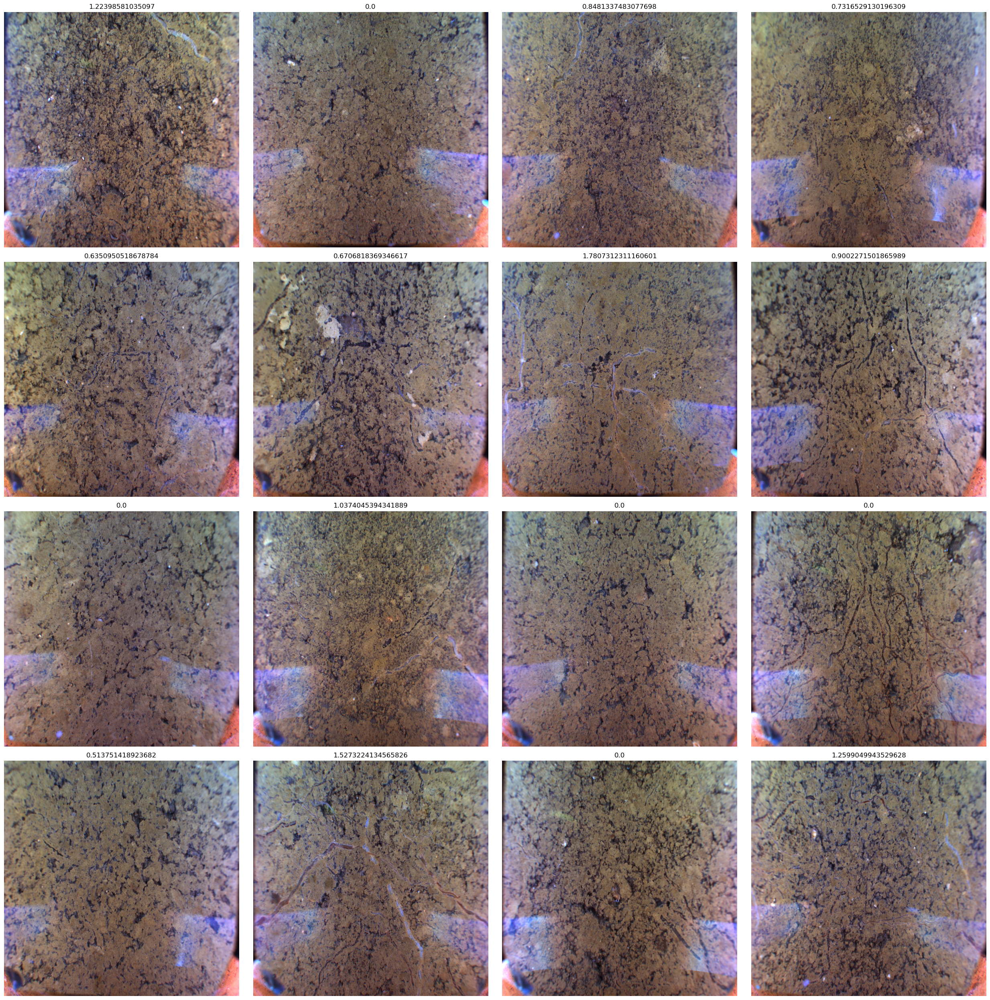

In [53]:
plt.figure(figsize=(25,25))
x1, y1 = train_generator[511]
for i in range(1,17):
    plt.subplot(4,4,i)   
    plt.imshow(x1[i-1])
    plt.title(str(y1[i-1]))
    #plt.title("Tube "+str(tube_no)+"   Depth: "+str(np.round(soil_depth,2))+" cm")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [60]:
#Test ImageDataGenerator 

In [61]:
#test_datagen = ImageDataGenerator(preprocess_input) 
test_datagen = ImageDataGenerator(rescale = 1./255)
test_generator = test_datagen.flow_from_dataframe(dataframe=test_df, directory=images_dir, 
                                              x_col="id", y_col="pRLD", has_ext=True, 
                                              class_mode="raw",target_size=(2048, 2048), 
                                              batch_size=16,shuffle=False,validate_filenames=True)

Found 4139 validated image filenames.


In [ ]:
plt.figure(figsize=(25,25))
x1, y1 = test_generator[50]
for i in range(1,17):
    plt.subplot(4,4,i)   
    plt.imshow(x1[i-1])
    plt.title(str(y1[i-1]))
    #plt.title("Tube "+str(tube_no)+"   Depth: "+str(np.round(soil_depth,2))+" cm")
    plt.axis('off')
plt.tight_layout()
plt.show()

# pip install gradient-accumulator


In [37]:
pip install gradient-accumulator


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 2.8 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [ ]:

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from gradient_accumulator import GradientAccumulateModel
import pandas as pd
from tensorflow.keras.callbacks import EarlyStopping
import keras.backend as K

def r_square(y_true, y_pred):
    SS_res =  K.sum(K.square(y_true - y_pred)) 
    SS_tot = K.sum(K.square(y_true - K.mean(y_true))) 
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

# Set up model
model = Model()
inputs = Input(shape=(2048, 2048, 3))
x = Conv2D(32, (3, 3), activation='relu')(inputs)
x = MaxPooling2D((2, 2))(x)
x = Conv2D(64, (3, 3), activation='relu')(x)
x = MaxPooling2D((2, 2))(x)
x = Conv2D(128, (3, 3), activation='relu')(x)
x = MaxPooling2D((2, 2))(x)
x = Conv2D(128, (3, 3), activation='relu')(x)
x = MaxPooling2D((2, 2))(x)
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
outputs = Dense(1,activation='linear')(x)
monitor = EarlyStopping(monitor='val_loss', min_delta=1e-3, patience=3, verbose=1, mode='auto',restore_best_weights=True)
# Set up optimizer and gradient accumulation
model = Model(inputs=inputs, outputs=outputs)
model = GradientAccumulateModel(accum_steps=4, inputs=model.input, outputs=model.output)
optimizer = 'adam'
model.compile(loss='mse', optimizer=optimizer,metrics = [r_square])

# Train model
history =model.fit(train_generator , epochs=10, validation_data=test_generator,callbacks=[monitor],verbose = 1)

In [94]:
def plot_models(history):
    
    fig, axs = plt.subplots(nrows = 2, ncols = 1, figsize=(10,10))
    axs[0].plot(history['val_loss'], label = 'validation loss', color = 'orange')
    axs[0].plot(history['loss'], label = 'training loss', color = 'blue')
    axs[0].set_ylabel('val loss')
    axs[0].set_xlabel('epoch')
    axs[0].legend()

    

In [ ]:
plot_models(history.history)
